<a href="https://colab.research.google.com/github/evmpython/2_codigos_gerais/blob/main/16_make_animation.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

**FAZENDO ANIMAÇÃO DE IMAGENS DE SATÉLITE**

---


- url dos dados: http://ftp.cptec.inpe.br/goes/goes16/goes16_web/ams_ret_ch13_baixa/

---


- Código realizado por: Enrique V. Mattos -- 13/05/2024 - enrique@unifei.edu.br.
- Código utilizado como referência de Diego Souza - https://github.com/diegormsouza

---



#Animação usando biblioteca `IMAGEIO`

--2024-05-13 13:54:10--  http://ftp.cptec.inpe.br/goes/goes16/goes16_web/ams_ret_ch13_baixa/2024/05/S11635388_202405010000.jpg
Resolving ftp.cptec.inpe.br (ftp.cptec.inpe.br)... 150.163.192.38
Connecting to ftp.cptec.inpe.br (ftp.cptec.inpe.br)|150.163.192.38|:80... connected.
HTTP request sent, awaiting response... 200 OK
Length: 1715967 (1.6M) [image/jpeg]
Saving to: ‘S11635388_202405010000.jpg’

S11635388_202405010 100%[===================>]   1.64M  1.02MB/s    in 1.6s    

2024-05-13 13:54:13 (1.02 MB/s) - ‘S11635388_202405010000.jpg’ saved [1715967/1715967]

--2024-05-13 13:54:13--  http://ftp.cptec.inpe.br/goes/goes16/goes16_web/ams_ret_ch13_baixa/2024/05/S11635388_202405010100.jpg
Resolving ftp.cptec.inpe.br (ftp.cptec.inpe.br)... 150.163.192.38
Connecting to ftp.cptec.inpe.br (ftp.cptec.inpe.br)|150.163.192.38|:80... connected.
HTTP request sent, awaiting response... 200 OK
Length: 1697420 (1.6M) [image/jpeg]
Saving to: ‘S11635388_202405010100.jpg’

S11635388_202405010 100%[==

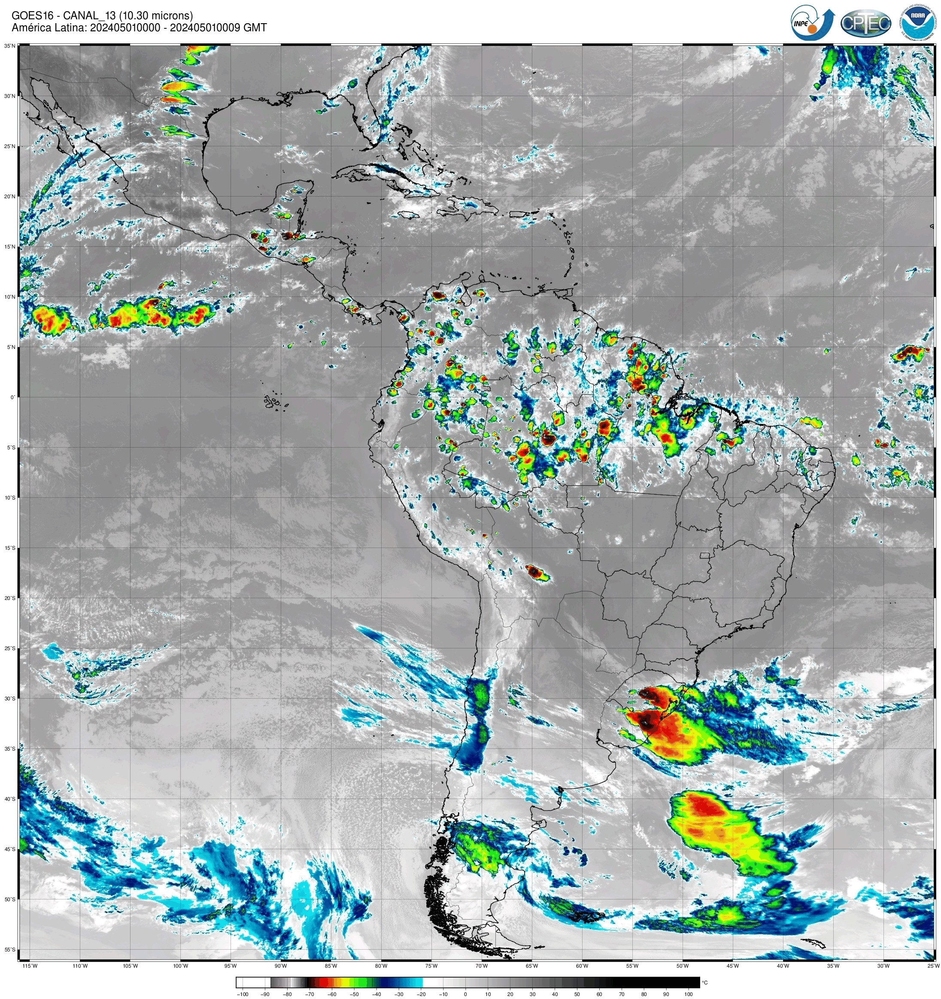

In [1]:
# importa bibliotecas
import imageio
import glob
import os
import warnings
warnings.filterwarnings("ignore")

# imagens que irão compor a animação
!wget http://ftp.cptec.inpe.br/goes/goes16/goes16_web/ams_ret_ch13_baixa/2024/05/S11635388_202405010000.jpg
!wget http://ftp.cptec.inpe.br/goes/goes16/goes16_web/ams_ret_ch13_baixa/2024/05/S11635388_202405010100.jpg
!wget http://ftp.cptec.inpe.br/goes/goes16/goes16_web/ams_ret_ch13_baixa/2024/05/S11635388_202405010200.jpg
!wget http://ftp.cptec.inpe.br/goes/goes16/goes16_web/ams_ret_ch13_baixa/2024/05/S11635388_202405010300.jpg
!wget http://ftp.cptec.inpe.br/goes/goes16/goes16_web/ams_ret_ch13_baixa/2024/05/S11635388_202405010400.jpg
files = sorted(glob.glob('/content/*jpg'), key=os.path.getmtime)

# cria animação
images = []
for file in files:
    images.append(imageio.imread(file))
imageio.mimsave(f'/content/animation_imageio.gif', images, duration=10, loop=0)

# abre a animação
from IPython.display import Image
Image(open(f'/content/animation_imageio.gif','rb').read(), width=600)

#Animação usando biblioteca `PIL`

--2024-05-13 13:55:19--  http://ftp.cptec.inpe.br/goes/goes16/goes16_web/ams_ret_ch13_baixa/2024/05/S11635388_202405010000.jpg
Resolving ftp.cptec.inpe.br (ftp.cptec.inpe.br)... 150.163.192.38
Connecting to ftp.cptec.inpe.br (ftp.cptec.inpe.br)|150.163.192.38|:80... connected.
HTTP request sent, awaiting response... 200 OK
Length: 1715967 (1.6M) [image/jpeg]
Saving to: ‘S11635388_202405010000.jpg.1’

S11635388_202405010 100%[===================>]   1.64M  1.33MB/s    in 1.2s    

2024-05-13 13:55:21 (1.33 MB/s) - ‘S11635388_202405010000.jpg.1’ saved [1715967/1715967]

--2024-05-13 13:55:21--  http://ftp.cptec.inpe.br/goes/goes16/goes16_web/ams_ret_ch13_baixa/2024/05/S11635388_202405010100.jpg
Resolving ftp.cptec.inpe.br (ftp.cptec.inpe.br)... 150.163.192.38
Connecting to ftp.cptec.inpe.br (ftp.cptec.inpe.br)|150.163.192.38|:80... connected.
HTTP request sent, awaiting response... 200 OK
Length: 1697420 (1.6M) [image/jpeg]
Saving to: ‘S11635388_202405010100.jpg.1’

S11635388_202405010 1

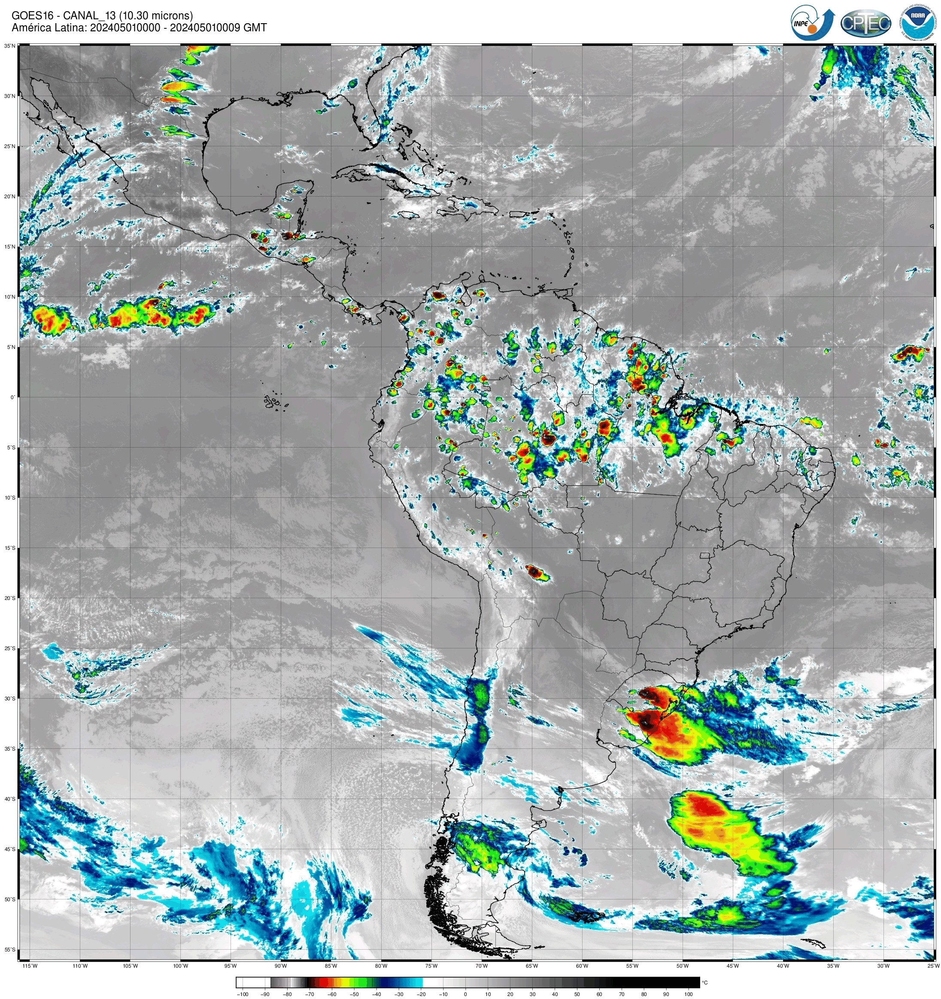

In [2]:
# importa bibliotecas
from PIL import Image
import os
import warnings
warnings.filterwarnings("ignore")

# imagens que irão compor a animação
!wget http://ftp.cptec.inpe.br/goes/goes16/goes16_web/ams_ret_ch13_baixa/2024/05/S11635388_202405010000.jpg
!wget http://ftp.cptec.inpe.br/goes/goes16/goes16_web/ams_ret_ch13_baixa/2024/05/S11635388_202405010100.jpg
!wget http://ftp.cptec.inpe.br/goes/goes16/goes16_web/ams_ret_ch13_baixa/2024/05/S11635388_202405010200.jpg
!wget http://ftp.cptec.inpe.br/goes/goes16/goes16_web/ams_ret_ch13_baixa/2024/05/S11635388_202405010300.jpg
!wget http://ftp.cptec.inpe.br/goes/goes16/goes16_web/ams_ret_ch13_baixa/2024/05/S11635388_202405010400.jpg
files = sorted(glob.glob('/content/*jpg'), key=os.path.getmtime)

# cria animação
img, *imgs = [Image.open(f) for f in files]
img.save(fp=f'/content/animation_PIL.gif', format='GIF', append_images=imgs, save_all=True, duration=10, loop=0)

# abre a animação
from IPython.display import Image
Image(open(f'/content/animation_PIL.gif','rb').read(), width=600)